In [1]:
import os
from functools import partial

import pickle
import matplotlib.pyplot as plt
import numpy as np
import torch

from openretina.hoefling_2024.configs import STIMULUS_RANGE_CONSTRAINTS
from openretina.hoefling_2024.nnfabrik_model_loading import Center, load_ensemble_retina_model_from_directory
from openretina.models.core_readout import CoreReadout
from openretina.optimization.objective import InnerNeuronVisualizationObjective, SingleNeuronObjective, SliceMeanReducer
from openretina.optimization.optimization_stopper import OptimizationStopper
from openretina.optimization.optimizer import optimize_stimulus
from openretina.optimization.regularizer import (
    ChangeNormJointlyClipRangeSeparately,
    RangeRegularizationLoss,
)
from openretina.plotting import plot_stimulus_composition, save_stimulus_to_mp4_video, play_stimulus
from openretina.stimuli import load_stimulus

In [42]:
model_path = "/gpfs01/euler/User/tzenkel/GitRepos/open-retina/exp/high_res_seed_42/csv/version_4/checkpoints/epoch=48-step=13132.ckpt"
model_path_low_res = "/gpfs01/euler/User/tzenkel/GitRepos/open-retina/exp/low_res_seed_42/csv/version_0/checkpoints/epoch=24-step=6700.ckpt"
model = CoreReadout.load_from_checkpoint(model_path)
model_low_res = CoreReadout.load_from_checkpoint(model_path_low_res)

example_input.shape[1:]=torch.Size([2, 150, 72, 64]) in_shape_readout=torch.Size([16, 120, 18, 16])
example_input.shape[1:]=torch.Size([2, 150, 18, 16]) in_shape_readout=torch.Size([16, 120, 18, 16])


In [18]:
mg_high_res_path = "/gpfs01/euler/User/tzenkel/Stimuli/moving_gratingsv4_4_60Hz_72x64.pickle"
mg_high_res = load_stimulus(mg_high_res_path, normalize=True, trigger_times=None, num_triggers_per_repetition=1)
mg_high_res = mg_high_res[::2]  # 60Hz to 30Hz

mg_low_res_path = "/gpfs01/euler/User/tzenkel/Stimuli/moving_gratingsv4_4_60Hz_18x16.pickle"
mg_low_res = load_stimulus(mg_low_res_path, normalize=True, trigger_times=None, num_triggers_per_repetition=1)
mg_low_res = mg_low_res[::2]  # 60Hz to 30Hz


In [4]:
mg_high_res = mg_high_res[::2]  # 60Hz to 30Hz
print(mg_high_res.shape)

(3960, 72, 64, 2)


torch.Size([2, 3960, 72, 64])


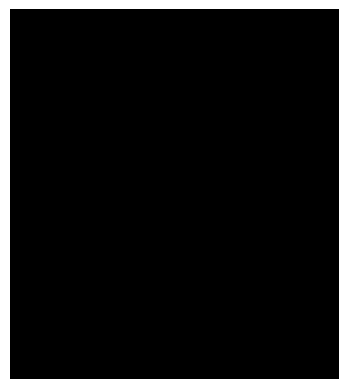

In [17]:
tens = torch.Tensor(mg_high_res).permute(-1, 0, 1, 2)
print(tens.shape)
play_stimulus(tens)

torch.Size([2, 3960, 18, 16])


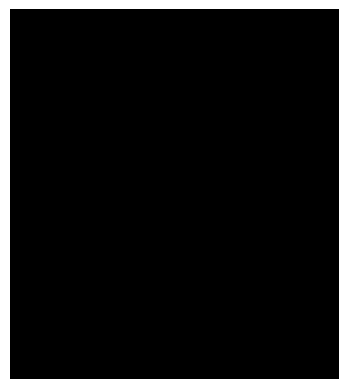

In [41]:
tens_low_res = torch.Tensor(mg_low_res).permute(-1, 0, 1, 2)
print(tens_low_res.shape)
play_stimulus(tens_low_res)

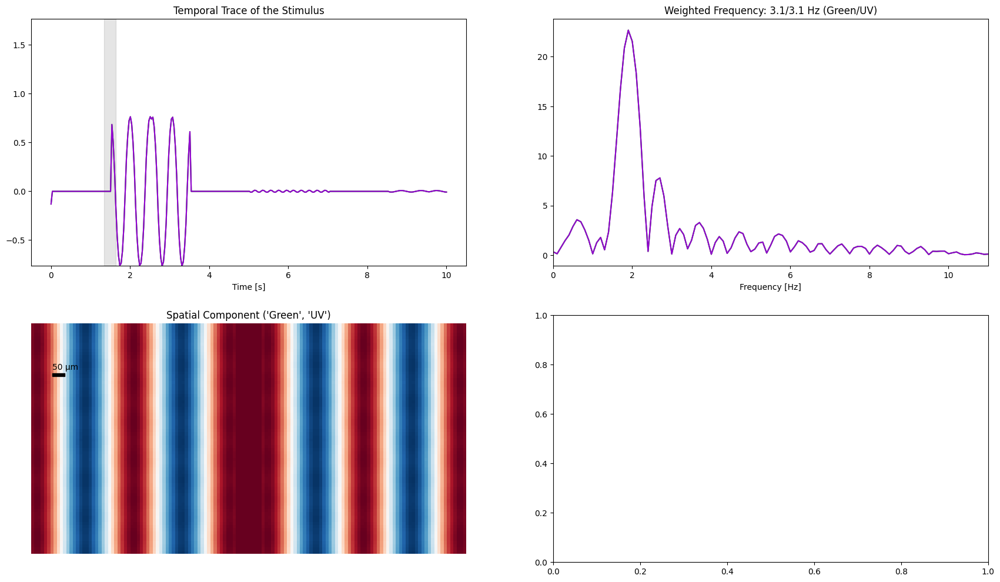

In [16]:
#fig, axes = plt.subplots(2, 2, figsize=(7 * 3, 12))
#plot_stimulus_composition(
#    stimulus=torch.Tensor(mg_high_res).permute(-1, 0, 1, 2).numpy(),
#    temporal_trace_ax=axes[0, 0],
#    freq_ax=axes[0, 1],
#    spatial_ax=axes[1, 0],
#    highlight_x_list=[(40, 49)],
#)

In [7]:
inp_moving_gratings = tens.unsqueeze(0).cuda()
output = model.forward(inp_moving_gratings, "session_1_ventral2_20210910")
traces = output.cpu().detach().numpy()[0]

outp_zero = model.forward(torch.zeros_like(inp_moving_gratings), "session_1_ventral2_20210910")
traces_zero = outp_zero.cpu().detach().numpy()[0]

In [44]:
inp_moving_gratings_low_res = tens_low_res.unsqueeze(0).cuda()
output_low_res = model_low_res.forward(inp_moving_gratings_low_res, "session_1_ventral2_20210910")
traces_low_res = output_low_res.cpu().detach().numpy()[0]

outp_zero_low_res = model_low_res.forward(torch.zeros_like(inp_moving_gratings_low_res), "session_1_ventral2_20210910")
traces_zero_low_res = outp_zero_low_res.cpu().detach().numpy()[0]

In [21]:
from openretina.video_analysis import decompose_kernel
temporal, spatial, _ = decompose_kernel(tens.numpy()[0])
print(f"{temporal.shape=} {tens.shape=}")

temporal.shape=(3960,) tens.shape=torch.Size([2, 3960, 72, 64])


(3960,)


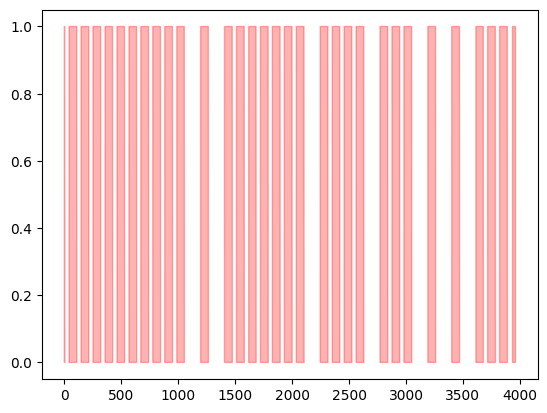

In [36]:
temporal_smeared = np.convolve(np.abs(temporal), np.ones(10)/10, mode="same")
mask_stimulus = temporal_smeared > 0.01
plt.fill_between(range(len(mask_stimulus)), 0.0, 1.0, where=mask_stimulus, color='red', alpha=0.3, label='Mask', interpolate=True)
print(mask_stimulus.shape)

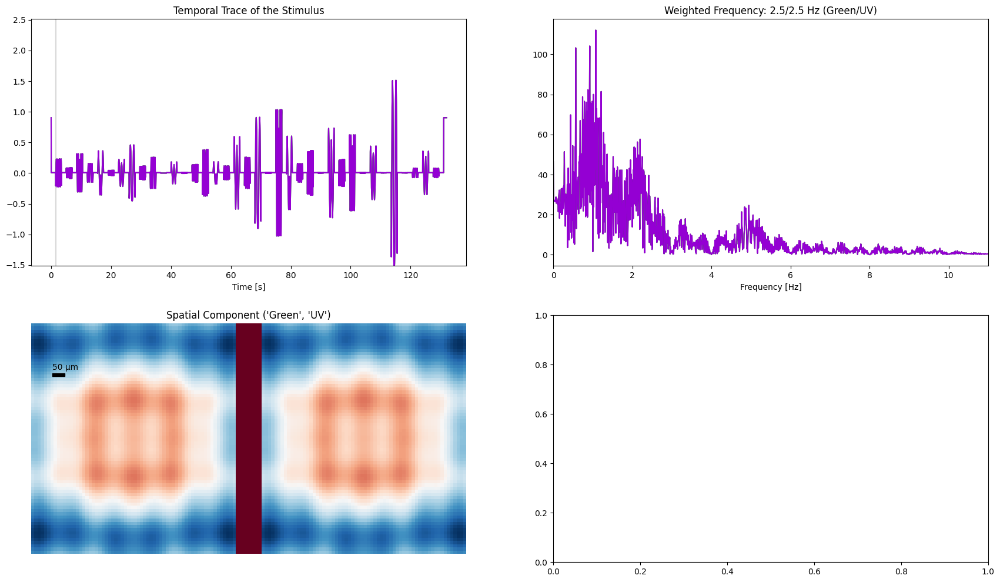

In [19]:
fig, axes = plt.subplots(2, 2, figsize=(7 * 3, 12))
plot_stimulus_composition(
    stimulus=torch.Tensor(mg_high_res).permute(-1, 0, 1, 2).numpy(),
    temporal_trace_ax=axes[0, 0],
    freq_ax=axes[0, 1],
    spatial_ax=axes[1, 0],
    highlight_x_list=[(40, 49)],
)

Text(0.5, 1.0, 'High resolution (74x64) model: ON contrast suppr. cell')

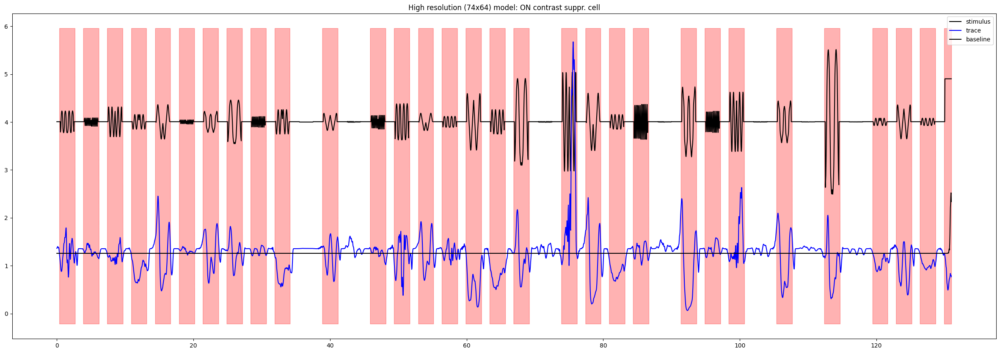

In [67]:
# plt.plot(traces[:, 10])
plt.figure(figsize=(30, 10))
time = np.arange(traces.shape[0]) / 30.0
plt.plot(time, temporal[30:] + 4, color="black", label="stimulus")
plt.plot(time, traces[:, 28], color="blue", label="trace")
plt.plot(time, traces_zero[:, 28], color="black", label="baseline")
ymin, ymax = plt.ylim()
plt.legend()
plt.fill_between(time, ymin, ymax, where=mask_stimulus[30:], color='red', alpha=0.3, label='Mask', interpolate=True)
plt.title("High resolution (74x64) model: ON contrast suppr. cell")

Text(0.5, 1.0, 'Low resolution (18x16) model: ON contrast suppr. cell')

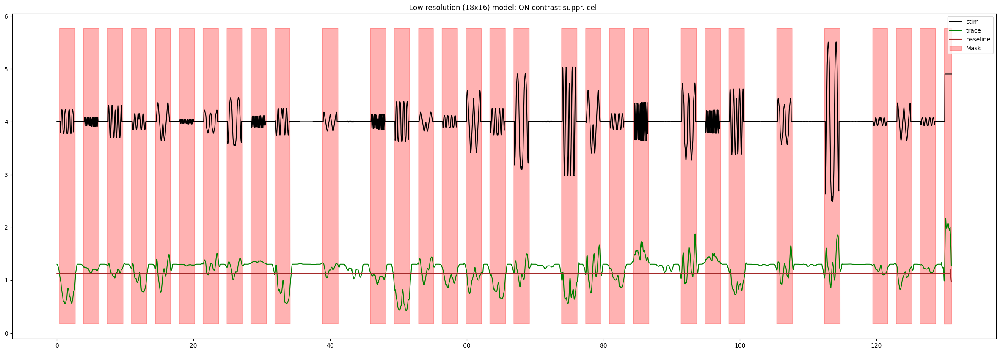

In [64]:
plt.figure(figsize=(30, 10))
time = np.arange(traces.shape[0]) / 30.0
plt.plot(time, temporal[30:] + 4, color="black", label="stim")
plt.plot(time, traces_low_res[:, 28], color="green", label="trace")
plt.plot(time, traces_zero_low_res[:, 28], color="brown", label="baseline")
ymin, ymax = plt.ylim()
plt.fill_between(time, ymin, ymax, where=mask_stimulus[30:], color='red', alpha=0.3, label='Mask', interpolate=True)
plt.legend()
plt.title("Low resolution (18x16) model: ON contrast suppr. cell")